In [11]:
# DEPRECATED SCRAPING METHOD, TOO SLOW

from selenium import webdriver
from bs4 import BeautifulSoup
import pandas as pd

# Setup driver and get page borrowed from: https://www.edureka.co/blog/web-scraping-with-python/#steps
driver = webdriver.Chrome("C:\BAC\/chromedriver")

def get_text(link):
    driver.get(link)
    content = driver.page_source
    soup = BeautifulSoup(content)
    text = ""
    for textWrapper in soup.findAll('div', attrs={'class':'content-list-component yr-content-list-text text'}):
        text += textWrapper.find('p').text + " "
    return text



In [3]:
# DEFINING FUNCTIONS 

import requests
from bs4 import BeautifulSoup

def get_text(url):
    page = requests.get(url)
    soup = BeautifulSoup(page.content, "html.parser")  
    text = ""
    for paragraph_wrapper in soup.findAll('div', attrs={'class':'content-list-component yr-content-list-text text'}):
        if paragraph_wrapper.find('p') is not None:
            p =  paragraph_wrapper.find('p').text
            # t.replace("\u", " ")
            p = p.replace("\u201c", ' ')
            p = p.replace('\u201d', ' ')
            p = p.replace('\u00a0', ' ')
            text += p + " "
    for paragraph_wrapper in soup.findAll('div', attrs={'class':'primary-cli cli cli-text '}):
        if paragraph_wrapper.find('p') is not None:
            p =  paragraph_wrapper.find('p').text
            # t.replace("\u", " ")
            p = p.replace("\u201c", ' ')
            p = p.replace('\u201d', ' ')
            p = p.replace('\u00a0', ' ')
            text += p + " "
    if text == "":
        print("NO TEXT FOUND url:", url)
        print("soup:", soup)
    return text

def filter_articles(categories, articles):
    filt_articles = []
    for article in articles:
        if article['category'] in categories and article['link'].find("https://www.huffingtonpost.comhttp") == -1:
            filt_articles.append(article)
    return filt_articles

In [20]:
# OPENING AND FILTERING DATASET FROM KAGGLE: https://www.kaggle.com/rmisra/news-category-dataset

import json

with open('./datasets/1_newsDataset.json') as json_file:
    data = json.load(json_file)
    articles = data['articles']

men_categories = ['SPORTS', 'MONEY', 'BUSINESS']
women_categories = ['WOMEN', 'STYLE & BEAUTY']

filtered_data = {}
filtered_data['articles'] = filter_articles(men_categories+women_categories, articles)

with open('./datasets/2_filtered_news_data.json', "w") as outFile:
    json.dump(filtered_data, outFile)

In [21]:
# VERY DUMB CODE MAKING A SMALL FILTERED NEWS DATASET
with open('./datasets/2_filtered_news_data.json') as json_file:
    data = json.load(json_file)


sportCounter = 0
moneyCounter = 0
businessCounter = 0
womenCounter = 0
styleandbeuaCounter = 0

filtered_data_SM = {}
filtered_data_SM['articles'] = []

for article in data['articles']:
    if article['category'] == "SPORTS" and sportCounter < 100:
        filtered_data_SM['articles'].append(article)
        sportCounter += 1
    if article['category'] == "MONEY" and moneyCounter < 100:
        filtered_data_SM['articles'].append(article)
        moneyCounter += 1
    if article['category'] == "BUSINESS" and businessCounter < 50:
        filtered_data_SM['articles'].append(article)
        businessCounter += 1 
    if article['category'] == "WOMEN" and womenCounter < 125:
        filtered_data_SM['articles'].append(article)
        womenCounter += 1
    if article['category'] == "STYLE & BEAUTY" and styleandbeuaCounter < 125:
        filtered_data_SM['articles'].append(article)
        styleandbeuaCounter += 1

with open('./datasets/2_filtered_news_data_SM.json', "w") as outFile:
    json.dump(filtered_data_SM, outFile)

NO TEXT FOUND url: https://www.huffingtonpost.com/entry/trump-auto-probe-china-tariffs_us_5b067d30e4b07c4ea105063a
soup: <!DOCTYPE html>
<html lang="en"><head><meta content="width=device-width, initial-scale=1.0, minimum-scale=1.0" name="viewport"/><meta charset="utf-8"/><title>U.S. Launches Auto Import Probe, China Vows To Defend Its Interests | HuffPost Impact</title><script type="text/javascript">window.NREUM||(NREUM={});NREUM.info = {"agent":"","beacon":"bam-cell.nr-data.net","errorBeacon":"bam-cell.nr-data.net","licenseKey":"80e7eedc19","applicationID":"820302374","applicationTime":14.010123,"transactionName":"YQdTZhAEDEoAVUMMDFhNdEoSFwdKElxESiRzNh4dBwsWSxgZH18QWhdWGjk7TWQaBRsYXB89GA1KXxJLDkBeAQZESmpTTx8/QlAaBRhKaUsOCAsBSmI9UmpOH20+VVNPAz9CUwJKTFlTGkUaTA0WVA0fCA==","queueTime":0,"ttGuid":"2cbc90052425a9cd","agentToken":null}; (window.NREUM||(NREUM={})).loader_config={licenseKey:"80e7eedc19",applicationID:"820302374"};window.NREUM||(NREUM={}),__nr_require=function(t,e,n){function r
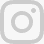
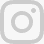
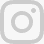
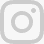
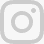
...
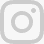
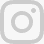
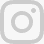
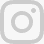
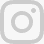

In [4]:
# ACTUALLY SCRAPING DATA TO GET FULL ARTICLE TEXT
import json

with open('./datasets/2_filtered_news_data_SM.json') as json_file:
    data = json.load(json_file)

men_categories = ['SPORTS', 'MONEY', 'BUSINESS']
women_categories = ['WOMEN', 'STYLE & BEAUTY']

scraped_data = {}
scraped_data['articles'] = []

for article in data['articles']:
    if article['category'] in men_categories:
        scraped_data['articles'].append({'gender': 'M', 'text': get_text(article['link'])})
    if article['category'] in women_categories:
        scraped_data['articles'].append({'gender': 'W', 'text': get_text(article['link'])})

In [23]:
# SAVING SCRAPED DATA TO JSON FILE

with open('./datasets/3_text_and_gender_SM.json', "w") as outFile:
    json.dump(scraped_data, outFile)